In [1]:
import os
import xml.etree.ElementTree as ET
from collections import Counter
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import cv2
%matplotlib inline

In [2]:
def get_objects_from_xml(xml_file):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    objects = [obj.find('name').text for obj in root.iter('object')]
    return objects

def count_objects_in_dir(dir_path):
    object_counts = Counter()
    for filename in os.listdir(dir_path):
        if filename.endswith('.xml'):
            xml_file = os.path.join(dir_path, filename)
            objects = get_objects_from_xml(xml_file)
            object_counts.update(objects)
    return object_counts

In [3]:
def plot_counts(object_counts):
    objects = list(object_counts.keys())
    counts = list(object_counts.values())

    fig = go.Figure(data=[go.Bar(
        x=objects,
        y=counts,
        text=counts,
        textposition='auto',
    )])

    fig.update_layout(
        title_text='Object Counts in XML Files',
        xaxis_title="Objects",
        yaxis_title="Counts",
        height=600
    )

    fig.show()

In [4]:
# Replace 'path_to_your_directory' with the path to your directory containing the XML files
dir_path = 'Annotations'
object_counts = count_objects_in_dir(dir_path)

# for object_name, count in object_counts.items():
#     print(f'{object_name}: {count}')

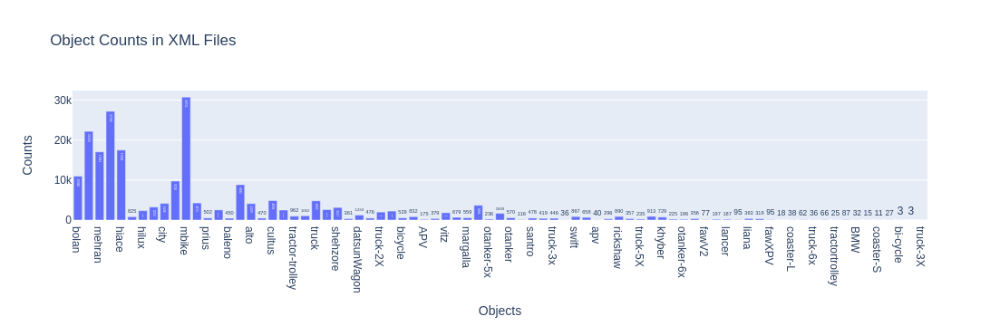

In [5]:
plot_counts(object_counts)

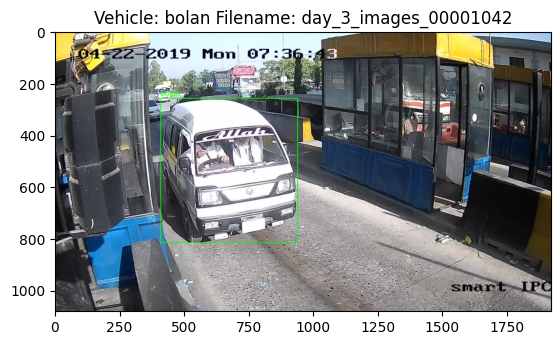

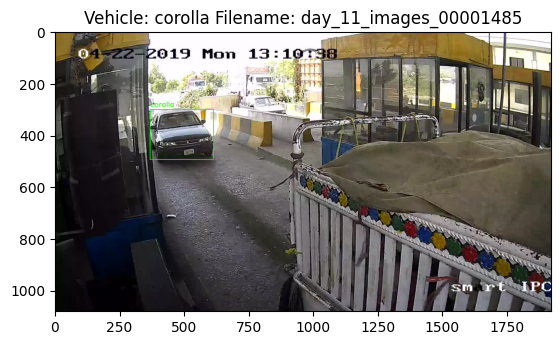

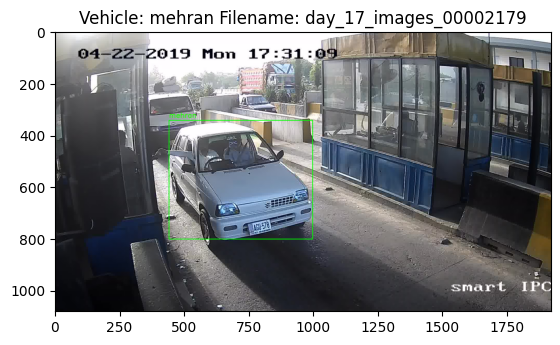

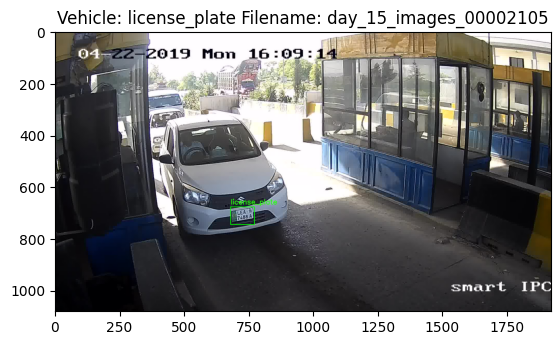

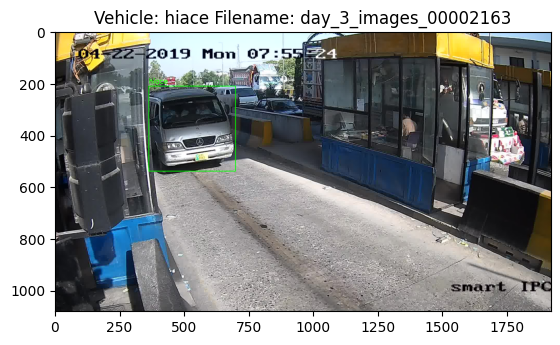

...

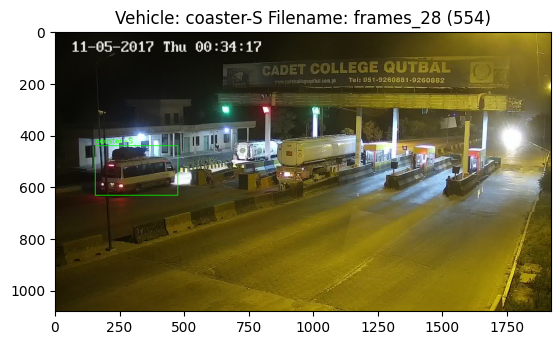

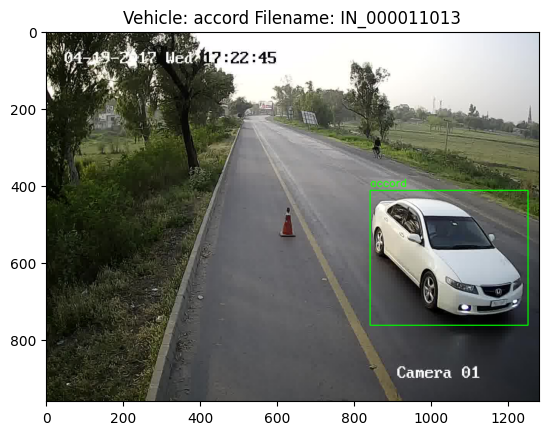

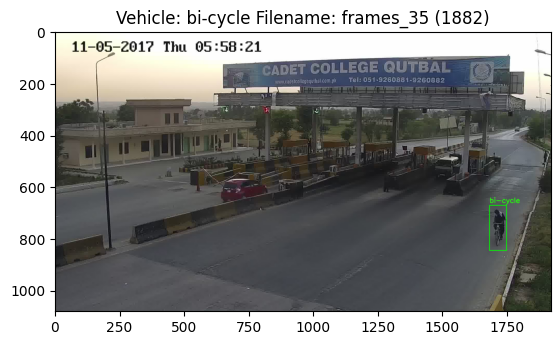

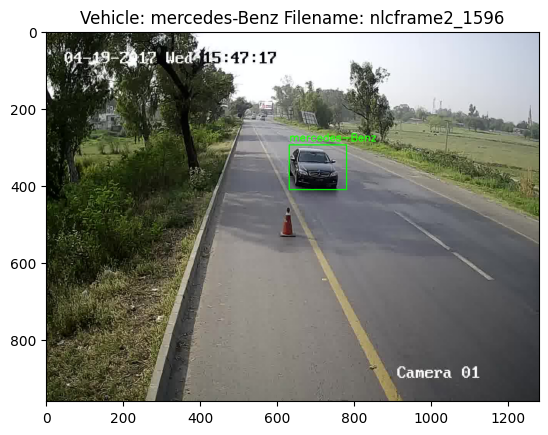

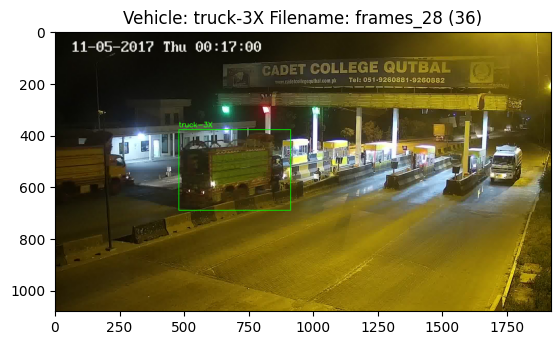

In [6]:
for key,value in object_counts.items():

    for filename in os.listdir('JPEGImages'):
    
        fn = filename.strip('.jpg')
        
    
        try:
            tree = ET.parse(f'Annotations/{fn}.xml')
            root = tree.getroot()
            objects = [obj.find('name').text for obj in root.iter('object')]
            # print(objects)

            if key in objects:
                img = cv2.imread(f'JPEGImages/{filename}')
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

                # Iterate over each 'object' element
                for obj in root.iter('object'):
                    
                    # get object name
                    obj_name = obj.find('name').text

                    if obj_name == key:
                        # Get bounding box coordinates
                        bndbox = obj.find('bndbox')
                        xmin = int(bndbox.find('xmin').text)
                        ymin = int(bndbox.find('ymin').text)
                        xmax = int(bndbox.find('xmax').text)
                        ymax = int(bndbox.find('ymax').text)
                
                        # Draw bounding box
                        img = cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
                
                        # Put object name
                        cv2.putText(img, obj_name, (xmin, ymin-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        
                plt.imshow(img)
                plt.title(f'Vehicle: {key} Filename: {fn}')
                plt.show()
                break
            
        except Exception as error:
            # print("An error occurred:", type(error).__name__, "–", error)
            continue

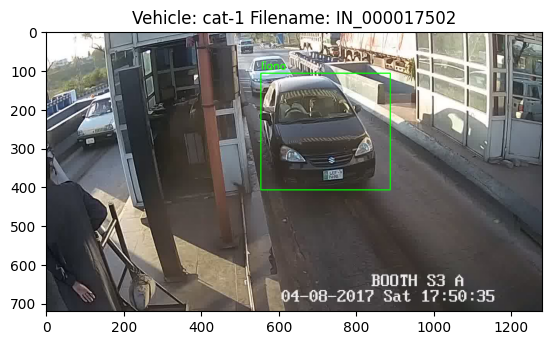

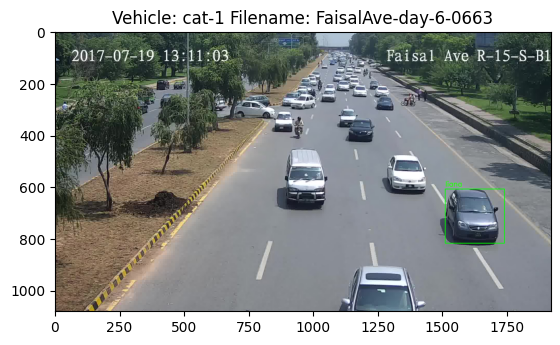

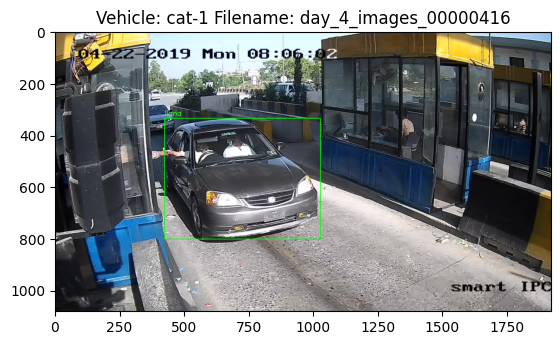

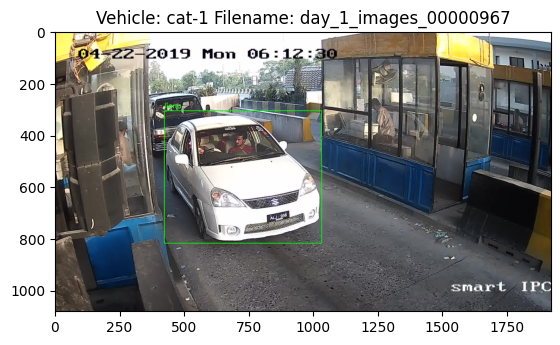

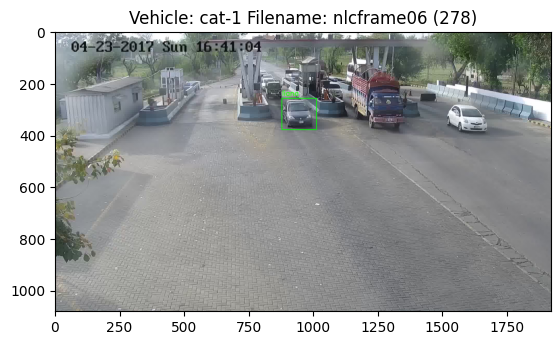

...

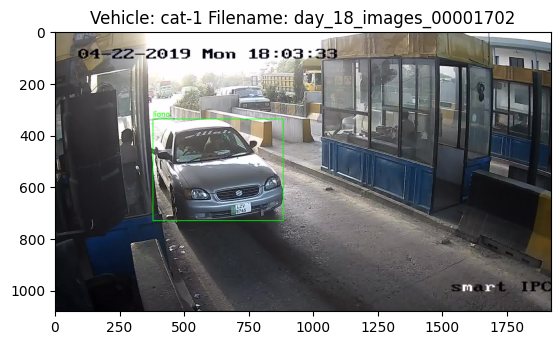

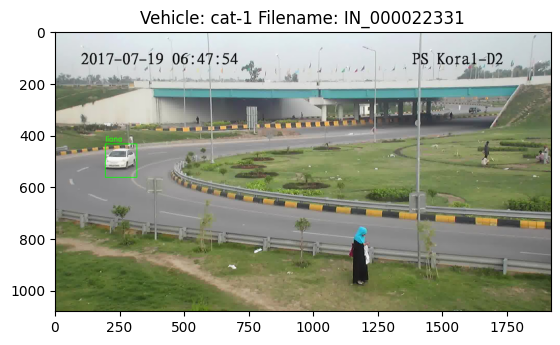

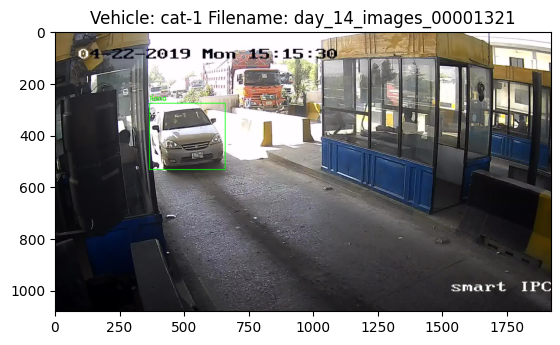

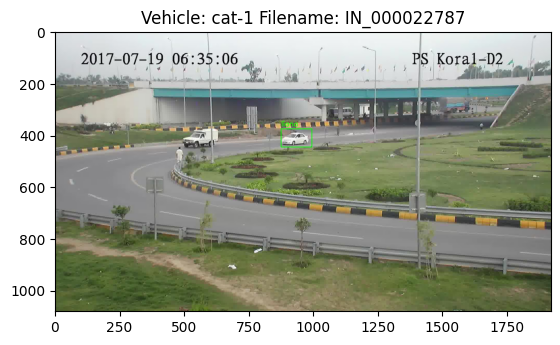

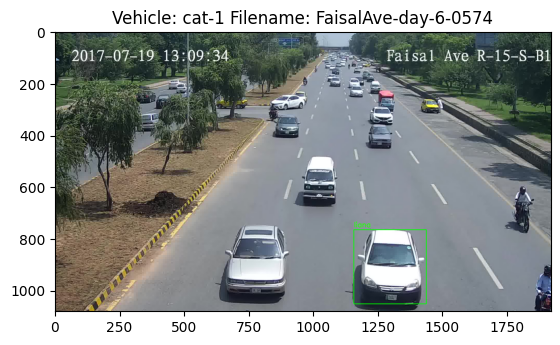

In [7]:
count = 0

for filename in os.listdir('JPEGImages'):

    fn = filename.strip('.jpg')
    

    try:
        tree = ET.parse(f'Annotations/{fn}.xml')
        root = tree.getroot()
        objects = [obj.find('name').text for obj in root.iter('object')]
        # print(objects)

        if 'liana' in objects:
            img = cv2.imread(f'JPEGImages/{filename}')
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Iterate over each 'object' element
            for obj in root.iter('object'):
                
                # get object name
                obj_name = obj.find('name').text

                if obj_name == 'liana':
                    # Get bounding box coordinates
                    bndbox = obj.find('bndbox')
                    xmin = int(bndbox.find('xmin').text)
                    ymin = int(bndbox.find('ymin').text)
                    xmax = int(bndbox.find('xmax').text)
                    ymax = int(bndbox.find('ymax').text)
            
                    # Draw bounding box
                    img = cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            
                    # Put object name
                    cv2.putText(img, obj_name, (xmin, ymin-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
    
            plt.imshow(img)
            plt.title(f'Vehicle: cat-1 Filename: {fn}')
            plt.show()
            count += 1
            
            if count == 15:
                break
        
    except Exception as error:
        # print("An error occurred:", type(error).__name__, "–", error)
        continue

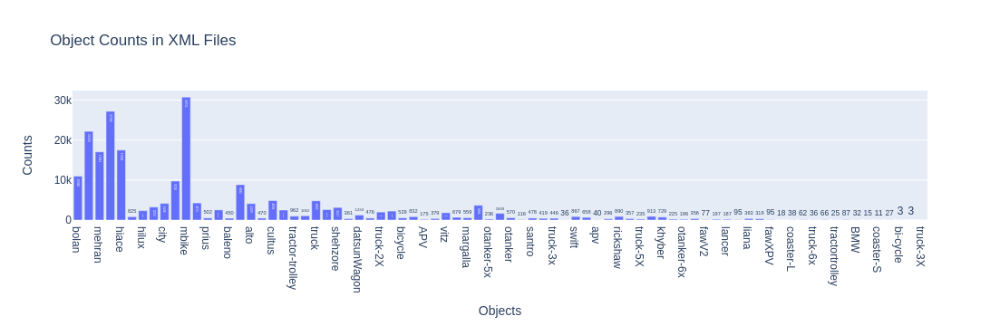

In [8]:
plot_counts(object_counts)

In [9]:
pickup = [ 'bolan', 'pickUp' , 'shehzore' ]

SUV = [ 'hilux', 'prado', 'datsunWagon', 'jeep', 'fortuner']

mini_car = [ 'mehran', 'fX', 'alto', 'core', 'cultus', 'passo', 'vitz','wagonR', 'santro', 'kia', 'swift',
            'khyber', 'fawV2']

sedan = [ 'corolla', 'city', 'prius', 'baleno' , 'civic', 'proBox', 'margalla', 'mercedes-benz', 'camry', 'crv','lancer', 'liana',
          'mercedesBenz', 'BMW','accord', 'mercedes-Benz']

van = [ 'hiace' , 'every', 'APV', 'apv', 'fawXPV' ]

HTV = [ 'truck-6X', 'truck-3X-S', 'coaster-bus_S', 'tractor-trolley', 'truck', 'truck-2x', 'truck-2X', 'coaster-bus_L', 'coaster-bus-s',
        'truck-4X', 'minitruck', 'otanker-5x', 'otanker', 'truck-3x', 'tractor', 'truck-5X', 'coaster-bus', 'construction-other_machinery',
        'otanker-6x', 'otanker-3x', 'otanker-4x', 'coaster-bus-l', 'truck-3X-L', 'coaster-L', 'truck-6x', 'truck-4x', 'tractortrolley',
        'otanker-2X', 'coaster-S', 'truck-3X']

bike = [ 'mbike' , 'bicycle', 'bi-cycle' ]

mini = ['rickshaw', 'animalcart']

In [10]:
pickup_c = 0
SUV_c = 0
mini_car_c = 0
sedan_c = 0
van_c = 0
HTV_c = 0
bike_c = 0
mini_c = 0

for veh in pickup:
    pickup_c += object_counts[veh]

for veh in SUV:
    SUV_c += object_counts[veh]

for veh in mini_car:
    mini_car_c += object_counts[veh]

for veh in sedan:
    sedan_c += object_counts[veh]

for veh in van:
    van_c += object_counts[veh]

for veh in HTV:
    HTV_c += object_counts[veh]

for veh in bike:
    bike_c += object_counts[veh]

for veh in mini:
    mini_c += object_counts[veh]

In [11]:
print(f' pickp: {pickup_c} \n SUV: \t{SUV_c} \n m-car: {mini_car_c} \n sedan: {sedan_c} \n van: \t{van_c} \n HTV: \t{HTV_c} \n bike: \t{bike_c} \n mini: \t{mini_c}')

 pickp: 23825 
 SUV: 	6845 
 m-car: 34574 
 sedan: 32466 
 van: 	18866 
 HTV: 	26970 
 bike: 	31283 
 mini: 	905


In [12]:
print(object_counts['cat-1'])

8832


In [13]:
print(object_counts['mbike'])

30751


In [14]:
print(len(os.listdir('JPEGImages')))

101107
